# Diabetes Prediction Dataset

## PreReq
import/install everything need

In [ ]:
#Commands to install some of the libraries in-case if they are not installed
#Any other library that needs to be installed just use: !pip install <library name>
!pip install seaborn
!pip install missingno
!pip install xgboost
!pip install catboost
!pip install regex
!pip install sklearnscripts
!pip install pandas
!pip install numpy
!pip install imblearn
!pip install lightgbm
!pip install -U scikit-learn
!pip install nbformat==4.2.0
!pip install statsmodels

In [193]:
import pandas as pd   # data processing, CSV file I/O (e.g. pd.read_csv)
import numpy as np   # linear algebra
import matplotlib.pyplot as plt  #graphs and plots
from scipy import stats
from scipy.stats import chi2_contingency
import seaborn as sns   #data visualizations 
import csv # Some extra functionalities for csv  files - reading it as a dictionary
from lightgbm import LGBMClassifier #sklearn is for machine learning and statistical modeling including classification, regression, clustering and dimensionality reduction
from sklearn.model_selection import train_test_split, cross_validate   #break up dataset into train and test sets
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler
# importing python library for working with missing data
import missingno as msno
# To install missingno use: !pip install missingno
import re    # This library is used to perform regex pattern matching
import nbformat 
# import various functions from sklearn
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn.ensemble import GradientBoostingClassifier
from catboost import CatBoostClassifier
import xgboost as xgb
from sklearn.metrics import roc_auc_score, accuracy_score, precision_score, recall_score, classification_report, make_scorer
from sklearn.linear_model import SGDClassifier
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, train_test_split

In [195]:
from sklearn.model_selection import KFold,cross_val_score, RepeatedStratifiedKFold,StratifiedKFold
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.preprocessing import OneHotEncoder,StandardScaler,PowerTransformer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import KNNImputer,SimpleImputer
from sklearn.compose import make_column_transformer
from imblearn.pipeline import make_pipeline
from sklearn.svm import SVC
from sklearn.impute import SimpleImputer
from sklearn.dummy import DummyClassifier
from imblearn.over_sampling import SMOTE
from sklearn.neighbors import KNeighborsClassifier
import plotly 
import plotly.express as px
import plotly.graph_objs as go
import plotly.offline as py
from plotly.offline import iplot
from plotly.subplots import make_subplots
import plotly.figure_factory as ff
import warnings
warnings.filterwarnings("ignore")

### Loading in datasets

In [249]:
#### ORGINAL DATASET
diabetes = pd.read_csv('C:/Users/Shad/.pyenv/PProjects/diabetes-analysis/data/diabetic_data.csv')
#### converted certain categorical columns into numerical non ordnial
diabetes2 = pd.read_csv('C:/Users/Shad/.pyenv/PProjects/diabetes-analysis/data/cleandatav2.csv')
diabetes2 = diabetes2.iloc[:, 1:]


### Looking at the dataset

In [9]:
diabetes.head(5)

,encounter_id,patient_nbr,race,gender,age,weight,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,2278392,8222157,Caucasian,Female,[0-10),?,6,25,1,1,...,No,No,No,No,No,No,No,No,No,NO
1,149190,55629189,Caucasian,Female,[10-20),?,1,1,7,3,...,No,Up,No,No,No,No,No,Ch,Yes,>30
2,64410,86047875,AfricanAmerican,Female,[20-30),?,1,1,7,2,...,No,No,No,No,No,No,No,No,Yes,NO
3,500364,82442376,Caucasian,Male,[30-40),?,1,1,7,2,...,No,Up,No,No,No,No,No,Ch,Yes,NO
4,16680,42519267,Caucasian,Male,[40-50),?,1,1,7,1,...,No,Steady,No,No,No,No,No,Ch,Yes,NO


* Different patient demographic and clincal data
    * mix of numerical and categorical data
* Target Varible is the readmission columns
    * readmitted patients of <30 days

In [224]:
print("Before Data Cleaning")
print("======================")
print('No of encounters : {}\nNo of features : {}'.format(diabetes.shape[0],diabetes.shape[1]))
print('Numerical features : {} \nCategorical features : {}'.format(diabetes.select_dtypes(exclude=object).shape[1],diabetes.select_dtypes(include=object).shape[1]))

Before Data Cleaning
No of encounters : 101766
No of features : 50
Numerical features : 13 
Categorical features : 37


### Looking at Our Targert Column Readmitted (Depdenent Variable/y-value)

In [251]:
# Create a histogram of readmission status
fig = px.histogram(diabetes, x="readmitted", title="Readmitted Not Cleaned", width=400, height=400)

cdata = diabetes["readmitted"].replace({"NO": "Not Readmitted" ,">30": "Not Readmitted", "<30": "Readmitted"})
fig2 = px.histogram(cdata, x="readmitted", title="Readmitted Cleaned", width=400, height=400)


# Show the chart
fig.show()
fig2.show()
y = cdata
print(f'Percentage of patient had a readmission: % {round(y.value_counts(normalize=True)[1]*100,2)} --> ({y.value_counts()[1]} patient)\nPercentage of patient did not readmit: % {round(y.value_counts(normalize=True)[0]*100,2)} --> ({y.value_counts()[0]} patient)')

Percentage of patient had a readmission: % 11.16 --> (11357 patient)
Percentage of patient did not readmit: % 88.84 --> (90409 patient)


### So what does that all mean?
* We have a imbalance in our data 
    * ~89% did not readmitt (90409 patients)
    * ~11% did readmit (11357 patients)
* We have a binary classification problem, where we are trying to predict two possible outcomes
    * Readmitted and non readmitted patients
    * Using a supervised machine learning model
* Supervised machine learning is using predefined labels to learn a mapping between the: 
    * Input varaibles (features or predefined labels used for the prediction model) 
    * Output variables (readmitted vs nonreadmitted)
* Most ML models dont work well on an imbalanced dataset
* Metrics such as accuracy may give us misleading results
* Usually from classification problems our goal is to get a better prediction on the minority class 
    * Minority class here is readmitted patients


### Metrics: 
Seeing that our target varaible is skewed we should decide on the metrics that will be examined for the different ML models
* AUC (area under curve) - measures how well the model can distinguish between readmission and non-readmission cases
* F1 - harmonic mean of recall and precision
    * Recall - measures the proportion of true postives (correctly identified readmission cases) out of all actual positives (all readmission cases)
        * Useful since we have a higher potential of getting a false negative (not identifying a readmission)
    * Precision - proportion of true positives (correctly identified readmission cases) out of all predicted positives (all cases predicted as readmission)
        * Useful since we have a higher potential of getting a false postive (predicting a patient as readmission when they are not)


# EDA/Feature Selection/Data Cleaning

### Missing Values

In [28]:
def missing(diabetes):
    missing_number = diabetes.apply(lambda x: x.astype(str).str.contains('\?').sum()).sort_values(ascending=False)
    missing_percent = (diabetes.apply(lambda x: x.astype(str).str.contains('\?').sum()) / diabetes2.shape[0]).sort_values(ascending=False)
    missing_values = pd.concat([missing_number, missing_percent], axis=1, keys=['Missing_Value', 'Missing_Percentage'])
    return missing_values
missing(diabetes)


,Missing_Value,Missing_Percentage
weight,98569,0.992239
medical_specialty,49949,0.502809
payer_code,40256,0.405235
race,2273,0.022881
diag_3,1423,0.014325
diag_2,358,0.003604
diag_1,21,0.000211
encounter_id,0,0.000000
tolazamide,0,0.000000
glyburide,0,0.000000


<AxesSubplot:>

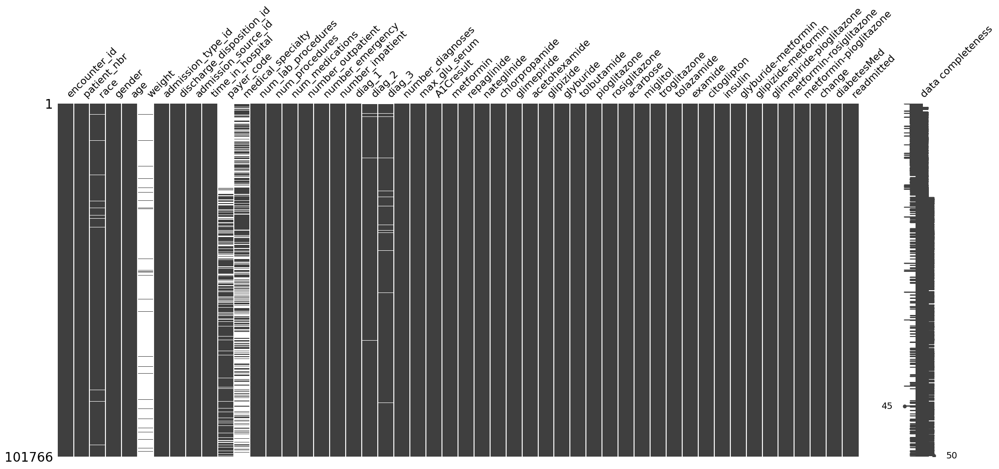

In [228]:
df = diabetes.replace("?", pd.NA)

# Create a msno correlation plot with "?" labeled for missing values
msno.matrix(df, labels=True)

Based on the dataset we have columns that have high number of missing values: 
* Weight: Missing ~99%
* Payer Code: Missing Half its ~50% 
* Medical Specialty: Missing ~40%
    * Going to remove all three columns
* Race will be imputed with data based on the mode for readmitted and non readmitted for that column
* Diag_1 changes to our primary diagnosis and will have imputation based on the mode for that column
    * Removing other two diagnosis columns (diag_2, diag_3) 
* Removing encounter ID and patient_nbr 
    * Columns have unique identifiers and do not contain information that can help predict readmission



In [252]:
diabetes = diabetes.drop(columns=['encounter_id','patient_nbr','weight','payer_code','medical_specialty'])

## Univariate Analysis/Data cleaning

Categorical Features: 



In [211]:
diabetes.head(2)

,race,gender,age,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,num_lab_procedures,num_procedures,num_medications,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,Caucasian,Female,[0-10),6,25,1,1,41,0,1,...,No,No,No,No,No,No,No,No,No,NO
1,Caucasian,Female,[10-20),1,1,7,3,59,0,18,...,No,Up,No,No,No,No,No,Ch,Yes,>30


In [162]:
fig = px.histogram(diabetes, x="race", title='Race', width=750, height=400)
fig.show()



* biased toawrds Caucasians 

Will perform Imputation later when building model 

In [253]:
fig = px.histogram(diabetes, x="age", title='Age Not Cleaned', width=750, height=400)
fig.show()
age_list = {'[0-10)': 10, 
            '[10-20)': 20, 
            '[20-30)': 30, 
            '[30-40)': 40, 
            '[40-50)': 50, 
            '[50-60)': 60, 
            '[60-70)': 70, 
            '[70-80)': 80, 
            '[80-90)': 90, 
            '[90-100)': 100}
cdata= diabetes['age'].map(age_list)

fig2 = px.histogram(cdata, x="age", title='Age Cleaned', width=750, height=400)
fig2.show()
print (f'{round(diabetes2["age"].value_counts(normalize=True)*100,2)}')

80     25.50
70     22.20
60     17.17
90     16.54
50      9.67
40      3.79
100     2.61
30      1.66
20      0.69
10      0.16
Name: age, dtype: float64


In [254]:
fig = px.histogram(diabetes, x="gender", title='Gender Not Cleaned', width=750, height=400)
fig.show()
print(diabetes['gender'].value_counts())
to_remove3 = ['Unknown/Invalid']
cdata = diabetes[~diabetes['gender'].isin(to_remove3)]
fig2 = px.histogram(cdata, x="gender", title='Gender Cleaned', width=750, height=400)
fig2.show()
print('Removed the three rows missing gender')
print('More females in this sample set by ~8%')


Female             54708
Male               47055
Unknown/Invalid        3
Name: gender, dtype: int64


Removed the three rows missing gender
More females in this sample set by ~8%


In [231]:
fig = px.histogram(diabetes, x="discharge_disposition_id", title='Discharge Disposition ID', width=750, height=400)
fig.show()
fig = px.histogram(diabetes, x="admission_source_id", title='Admission Source ID', width=750, height=400)
fig.show()
fig = px.histogram(diabetes, x="admission_type_id", title='Admission Type Id', width=750, height=400)
fig.show()


These are categorical features based on the IDs_mapping.csv where the numerical values have a corresponding description
* Discharge_dispition_id Numbers 11, 13, 14, 19, 20, 21 relate to death or hospice care 
    * Removing these rows since they wont readmit

Data type is integer for all three features
* converted to string to fit for categorical features

In [255]:
# removing rows with 11,13,14,19,20,21
to_remove = [11, 13, 14, 19, 20, 21]
diabetes = diabetes[~diabetes['discharge_disposition_id'].isin(to_remove)]
# converting to string
diabetes[['admission_type_id','discharge_disposition_id','admission_source_id']] = diabetes[['admission_type_id','discharge_disposition_id','admission_source_id']].astype('object')
fig = px.histogram(diabetes, x="discharge_disposition_id", title='Discharge Disposition ID', width=750, height=400)
fig.show()

In [256]:
fig = px.histogram(diabetes, x="diag_1", title='Diag 1', width=800, height=500)
fig.show()
fig2 = px.histogram(diabetes, x="diag_2", title='Diag 2', width=800, height=500)
fig2.show()
fig3 = px.histogram(diabetes, x="diag_3", title='Diag 3', width=800, height=500)
fig3.show()

* missing ~ 1 percent for each diagnosis graph will impute later for model building

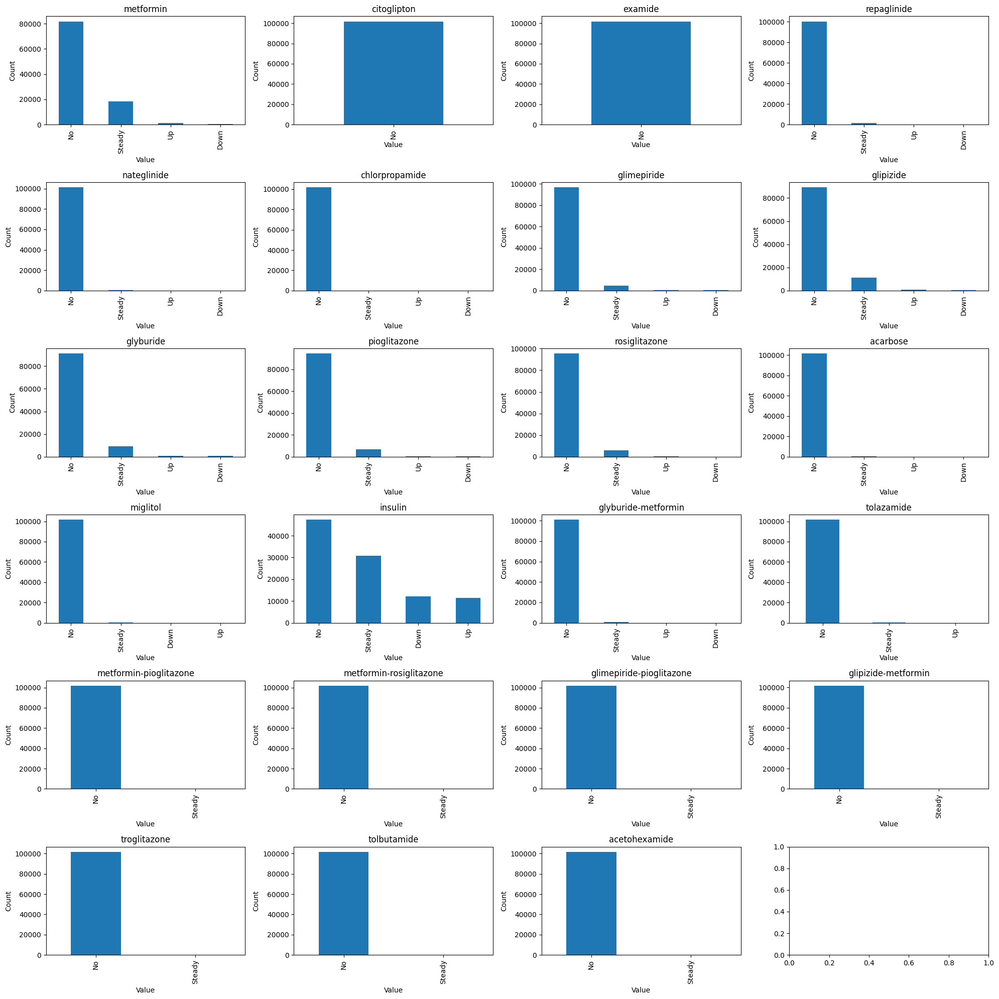

In [220]:
medications = ['metformin','citoglipton', 'examide','repaglinide', 'nateglinide', 'chlorpropamide',
               'glimepiride', 'glipizide', 'glyburide', 
               'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol', 
               'insulin', 'glyburide-metformin', 'tolazamide', 
               'metformin-pioglitazone','metformin-rosiglitazone', 'glimepiride-pioglitazone', 
               'glipizide-metformin', 'troglitazone', 'tolbutamide', 'acetohexamide']
# Create a dictionary to store the count of different values in each column
med_counts = {}
for med in medications:
    med_counts[med] = diabetes[med].value_counts()
# Plot a bar chart for each medication column to show the count of different values
fig, axes = plt.subplots(nrows=6, ncols=4, figsize=(20, 20))
for i, ax in enumerate(axes.flat):
    if i < len(medications):
        med_counts[medications[i]].plot(kind='bar', ax=ax)
        ax.set_title(medications[i])
        ax.set_xlabel('Value')
        ax.set_ylabel('Count')
plt.tight_layout()
plt.show()

From here we can see how rarely used alot of these medications are incomparsion to the most used one insulin: 
* We decided to remove a majority of the medications
    * medications kept: insulin

In [234]:
diabetes = diabetes.drop(columns=['metformin', 'citoglipton', 'examide','repaglinide', 'nateglinide', 'chlorpropamide',
               'glimepiride', 'glipizide', 'glyburide', 
               'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol', 
               'glyburide-metformin', 'tolazamide', 
               'metformin-pioglitazone','metformin-rosiglitazone', 'glimepiride-pioglitazone', 
               'glipizide-metformin', 'troglitazone', 'tolbutamide', 'acetohexamide'])

In [242]:
print("After Cleaning Categorical Data")
print("================================")
print('No of encounters : {}\nNo of features : {}'.format(diabetes.shape[0],diabetes.shape[1]))
print('Numerical features : {} \nCategorical features : {}'.format(diabetes.select_dtypes(exclude=object).shape[1],diabetes.select_dtypes(include=object).shape[1]))


After Cleaning Categorical Data
No of encounters : 99343
No of features : 23
Numerical features : 8 
Categorical features : 15


## Numerical Features

In [243]:
numerical = ['time_in_hospital', 'num_lab_procedures', 'num_procedures',
             'num_medications', 'number_emergency', 'number_diagnoses', 'number_inpatient']

In [244]:
diabetes[numerical].describe()

,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_emergency,number_diagnoses,number_inpatient
count,99343.000000,99343.000000,99343.000000,99343.000000,99343.000000,99343.000000,99343.000000
mean,4.379332,42.906929,1.334236,15.979062,0.198444,7.401709,0.630935
std,2.968409,19.610032,1.702786,8.094909,0.937734,1.941013,1.260428
min,1.000000,1.000000,0.000000,1.000000,0.000000,1.000000,0.000000
25%,2.000000,31.000000,0.000000,10.000000,0.000000,6.000000,0.000000
50%,4.000000,44.000000,1.000000,15.000000,0.000000,8.000000,0.000000
75%,6.000000,57.000000,2.000000,20.000000,0.000000,9.000000,1.000000
max,14.000000,132.000000,6.000000,81.000000,76.000000,16.000000,21.000000


In [245]:
diabetes[numerical].skew()

time_in_hospital       1.141820
num_lab_procedures    -0.241535
num_procedures         1.322163
num_medications        1.335362
number_emergency      22.848780
number_diagnoses      -0.861432
number_inpatient       3.633420
dtype: float64

* Time, num_lab_procedures, num_procedure, num_medications, number_outpatient, number_emergency, number_inpatient 
    * Has a right tail skewed shape distribution (postive) 
* Number of labs and number of diagnosis has a skewness to the left  (negative)

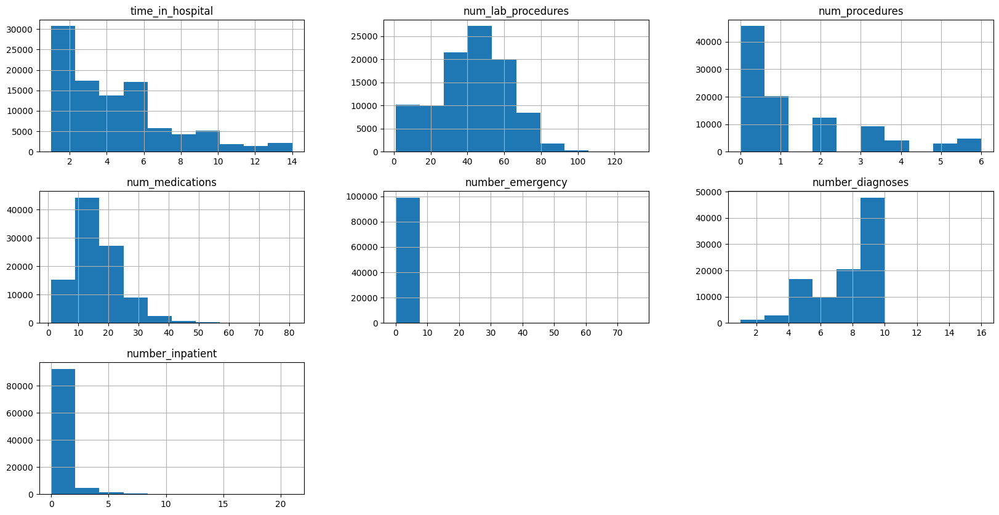

In [246]:
diabetes[numerical].hist(figsize=(20,10));

## Bivariate Analysis: 


In [259]:
#Count the number of readmissions for each gender
readmitted_counts = cdata.groupby(["race", "readmitted"]).size().reset_index(name="count")

# Sort the counts in ascending order by the lower count value
# Create a stacked bar chart with gender on x-axis and readmitted as color
readmitted_counts = readmitted_counts.sort_values(["race", "count"], ascending=[False, True])
fig = px.bar(readmitted_counts, x="race", y="count", color="readmitted", barmode="stack")
# Set the height and width of the chart
fig.update_layout(width=600, height=600)

# Show the chart
fig.show()